In [10]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
path = "/Users/christiannass/Documents/Arbeit/AxaChallenge"

In [2]:
dtype_dict = {
    "CRASH DATE": "string", 
    "CRASH TIME": "string", 
    "BOROUGH": "string", 
    "ZIP CODE": "string", 
    "LATITUDE": "float", 
    "LONGITUDE": "float", 
    "LOCATION": "string", 
    "ON STREET NAME": "string", 
    "CROSS STREET NAME": "string", 
    "OFF STREET NAME": "string", 
    "NUMBER OF PERSONS INJURED": "Int64", 
    "NUMBER OF PERSONS KILLED": "Int64",
    "NUMBER OF PEDESTRIANS INJURED": "Int64",
    "NUMBER OF PEDESTRIANS KILLED": "Int64", 
    "NUMBER OF CYCLIST INJURED": "Int64",
    "NUMBER OF CYCLIST KILLED": "Int64", 
    "NUMBER OF MOTORIST INJURED": "Int64",
    "NUMBER OF MOTORIST KILLED": "Int64", 
    "CONTRIBUTING FACTOR VEHICLE 1": "string",
    "CONTRIBUTING FACTOR VEHICLE 2": "string",
    "CONTRIBUTING FACTOR VEHICLE 3": "string",
    "CONTRIBUTING FACTOR VEHICLE 4": "string",
    "CONTRIBUTING FACTOR VEHICLE 5": "string",
    "COLLISION_ID": "Int64",
    "VEHICLE TYPE CODE 1": "string", 
    "VEHICLE TYPE CODE 2": "string",
    "VEHICLE TYPE CODE 3": "string",
    "VEHICLE TYPE CODE 4": "string",
    "VEHICLE TYPE CODE 5": "string"
}
df = pd.read_csv(f"{path}/data/Motor_Vehicle_Collisions_-_Crashes_20251030.csv", dtype = dtype_dict, parse_dates={"DATE": ["CRASH DATE", "CRASH TIME"]})

In [3]:
df_bike = df[df[[f"VEHICLE TYPE CODE {x}" for x in range(1,6)]].apply(lambda col: col.astype(str).str.contains('Bike').any(), axis=1)]

In [20]:
# Load some tripdata for comparison
dfs = []
for year in [2016]:
    dirpath = f"{path}/data/{year}-citibike-tripdata"
    csv_files = [os.path.join(dirpath, f) for f in os.listdir(dirpath) if f.endswith('tripdata.csv')]
    for fpath in csv_files:
        df = pd.read_csv(fpath)
        if "/" in df['StartTime'].iloc[0]:
            df['StartTime'] = pd.to_datetime(df['StartTime'], format='%m/%d/%Y %H:%M:%S')
        else:
            df['StartTime'] = pd.to_datetime(df['StartTime'], format='ISO8601')
        dfs.append(df)
df_trips = pd.concat(dfs, axis=0, ignore_index=True)
df_trips.head(5)

,TripDuration,StartTime,StartStationID,EndDtationID,BikeID,UserType,BirthYear,Gender
0,528,2016-12-01 00:00:04,499.0,228.0,26931,Subscriber,1964.0,1
1,218,2016-12-01 00:00:28,3418.0,3358.0,27122,Subscriber,1955.0,1
2,399,2016-12-01 00:00:39,297.0,345.0,19352,Subscriber,1985.0,1
3,254,2016-12-01 00:00:44,405.0,358.0,20015,Subscriber,1982.0,1
4,1805,2016-12-01 00:00:54,279.0,279.0,23148,Subscriber,1989.0,1


# 1. Analyse the dates and time of the crashes and compare them to the CitiBike trip data

<Axes: xlabel='Hour', ylabel='Number of crashes'>

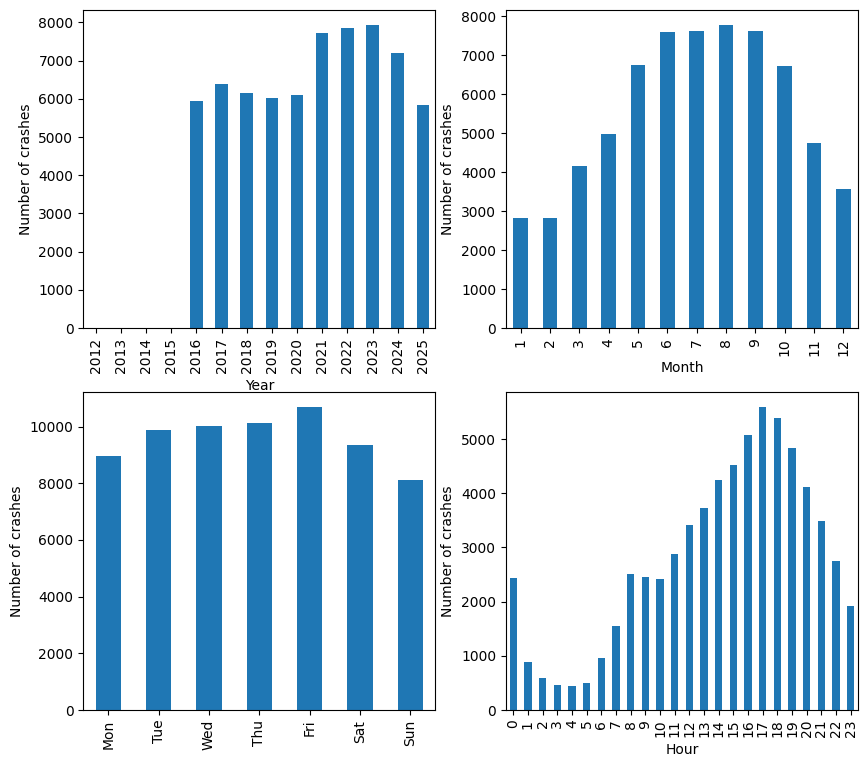

In [4]:
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(10, 7))
plt.subplots_adjust(bottom=0.0, right=0.9, top=1.0)
df_bike["DATE"].groupby(df_bike["DATE"].dt.year).count().plot(ax=axs[0,0], kind="bar", xlabel="Year", ylabel="Number of crashes")
df_bike["DATE"].groupby(df_bike["DATE"].dt.month).count().plot(ax=axs[0,1], kind="bar", xlabel="Month", ylabel="Number of crashes")
ax = df_bike["DATE"].groupby(df_bike["DATE"].dt.day_of_week).count().plot(ax=axs[1,0], kind="bar", xlabel="", ylabel="Number of crashes")
ax.set_xticks([0,1,2,3,4,5,6], labels=["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"])
df_bike["DATE"].groupby(df_bike["DATE"].dt.hour).count().plot(ax=axs[1,1], kind="bar", xlabel="Hour", ylabel="Number of crashes")

- Most data from 2016 onwards
- Number of crashes with a bike seem increase 
    - 2020 corona
    - 2025 not complete year
- Month, weekday and hour large correlation with bike rides overall
    - Need to know overall rides to infer risks
- Next compare crash data with CitiBike tripdata

Bike crashes in blue. Overlayed in red the number of CitiBike trips


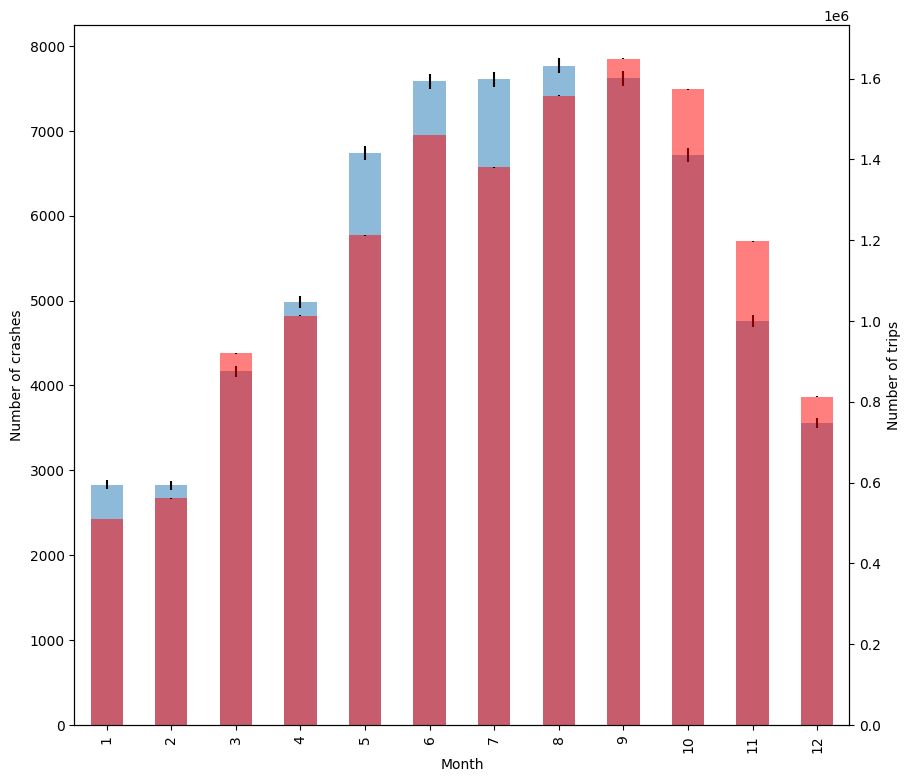

In [52]:
fig, ax1 = plt.subplots(figsize=(10, 7))
plt.subplots_adjust(bottom=0.0, right=0.9, top=1.0)

df_bike_month = df_bike["DATE"].groupby(df_bike["DATE"].dt.month).count()
ax1 = df_bike_month.plot(kind="bar", xlabel="Month", ylabel="Number of crashes", alpha=0.5, yerr= np.sqrt(df_bike_month))

ax2 = ax1.twinx()
df_trips_month = df_trips["StartTime"].groupby(df_trips["StartTime"].dt.month).count()
df_trips_month.plot(kind="bar", xlabel="Month", color="red", ylabel="Number of trips", alpha=0.5, yerr=np.sqrt(df_trips_month))
print("Bike crashes in blue. Overlayed in red the number of CitiBike trips")

- Clear differences between crashes in a month and CitiBike trips in a month
    - Reasons: CitiBike probably only small percentage of total bike rides.
    - Because of this cannot comment on correlation between month and risk of a crash (i.e. winter bad conditions more crashes or summer more traffic more crashes).
    - I think you can see here that CitiBike is often used by tourists visiting NYC in autuumn (A large fraction of casual users in that months would support this)

Bike crashes in blue. Overlayed in red the number of CitiBike trips


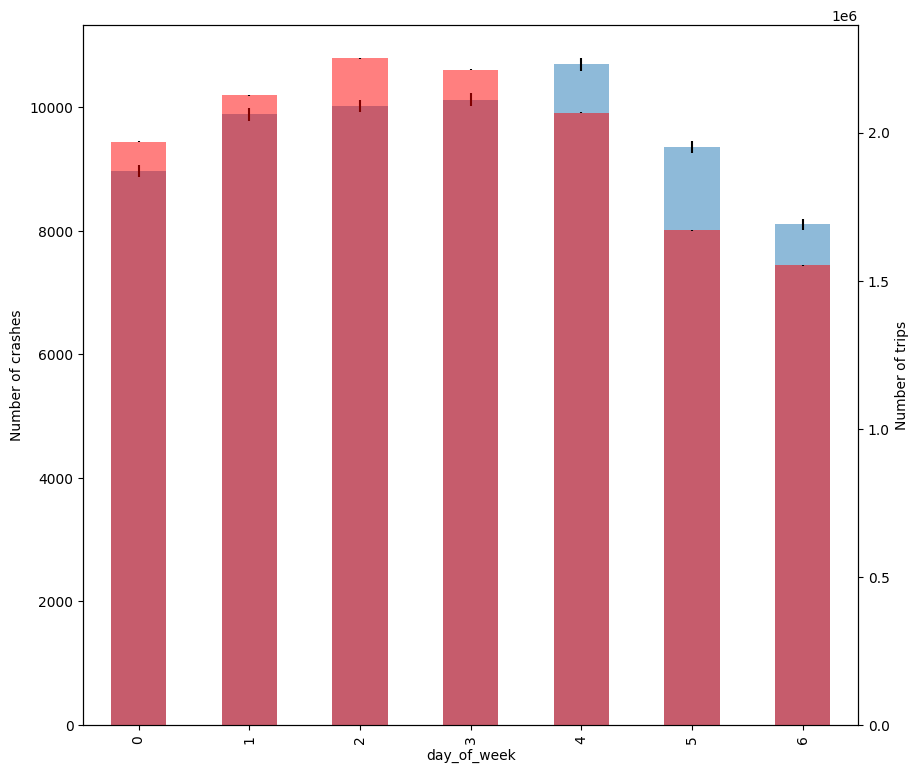

In [54]:
fig, ax1 = plt.subplots(figsize=(10, 7))
plt.subplots_adjust(bottom=0.0, right=0.9, top=1.0)

df_bike_day_of_week = df_bike["DATE"].groupby(df_bike["DATE"].dt.day_of_week).count()
ax1 = df_bike_day_of_week.plot(kind="bar", xlabel="day_of_week", ylabel="Number of crashes", alpha=0.5, yerr= np.sqrt(df_bike_day_of_week))

ax2 = ax1.twinx()
df_trips_day_of_week = df_trips["StartTime"].groupby(df_trips["StartTime"].dt.day_of_week).count()
df_trips_day_of_week.plot(kind="bar", xlabel="day_of_week", color="red", ylabel="Number of trips", alpha=0.5, yerr=np.sqrt(df_trips_day_of_week))
print("Bike crashes in blue. Overlayed in red the number of CitiBike trips")

- Either CitiBike is mostly used to commute to work, i.e. less trips on weekends
- Or the crash risk on weekends is higher (less experienced drivers, alcohol, etc.)

Bike crashes in blue. Overlayed in red the number of CitiBike trips


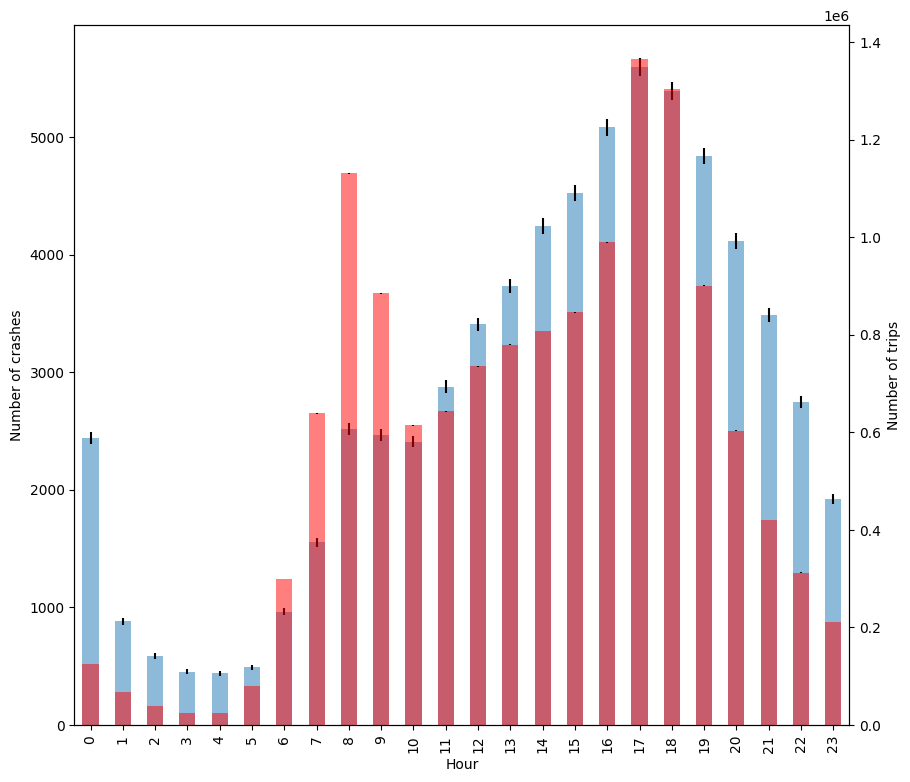

In [53]:
fig, ax1 = plt.subplots(figsize=(10, 7))
plt.subplots_adjust(bottom=0.0, right=0.9, top=1.0)

df_bike_hour = df_bike["DATE"].groupby(df_bike["DATE"].dt.hour).count()
ax1 = df_bike_hour.plot(kind="bar", xlabel="Hour", ylabel="Number of crashes", alpha=0.5, yerr= np.sqrt(df_bike_hour))

ax2 = ax1.twinx()
df_trips_hour = df_trips["StartTime"].groupby(df_trips["StartTime"].dt.hour).count()
df_trips_hour.plot(kind="bar", xlabel="hour", color="red", ylabel="Number of trips", alpha=0.5, yerr=np.sqrt(df_trips_hour))
print("Bike crashes in blue. Overlayed in red the number of CitiBike trips")

- Looks again like CitiBike is mostly used to commute to work (peaks at 8 and 17)
- Many crashes at night compared to trips
    - CitiBike only rarely used at night
    - Risk is increased due to bad visibility and worse physical condition of drivers

# 2. Analyse locations of crashes and compare to CitiBike station locations

In [69]:
import folium
df_bike_plot = df_bike.rename(columns={"VEHICLE TYPE CODE 1": "VTC1", "VEHICLE TYPE CODE 2": "VTC2", "CONTRIBUTING FACTOR VEHICLE 1": "CFV1", "CONTRIBUTING FACTOR VEHICLE 2": "CFV2"})
df_bike_plot = df_bike_plot.dropna(subset=["LATITUDE","LONGITUDE"])

In [96]:
m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

df_bike_plot1 = df_bike_plot.head(10000) # Plot only 1/6 of the data, otherwise the notebook becomes slow

for crash in df_bike_plot1.itertuples(index=False):
    folium.Circle(
        location=[crash.LATITUDE, crash.LONGITUDE],
        radius= 10,
        color="red",
        fill_opacity=1.0,
        fill_color="red",
        popup=f"...",
        tooltip=f"Participants:\n1. {crash.VTC1}: {crash.CFV1}\n2. {crash.VTC2}: {crash.CFV2}",
    ).add_to(m)
print("Map of accidents in which a Bike or E-Bike is involved.")
m

Map of accidents in which a Bike or E-Bike is involved.


In [97]:
from folium.plugins import HeatMap

m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_bike_plot[["LATITUDE","LONGITUDE"]],
    radius = 10,
    blur = 10,
    ).add_to(m)
print("Heatmap of crashes")
m

Heatmap of crashes


In [124]:
df_stations = pd.read_csv(f"{path}/data/2016-citibike-tripdata/stations.csv")

In [125]:
s_stationVisits = df_trips["StartStationID"].groupby(df_trips["StartStationID"]).count()
s_stationVisits.name = "N_visits"
s_stationVisits.index.name = "ID"
s_stationVisits
df_stations = df_stations.merge(s_stationVisits, on="ID")

In [133]:
import branca.colormap as cm
max_visits = df_stations["N_visits"].max()
linear = cm.LinearColormap(["green", "yellow", "red"], vmin=0, vmax=max_visits)

m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

for station in df_stations.itertuples(index=False):
    folium.Circle(
        location=[station.Lat, station.Lng],
        radius= 30,
        color=linear(station.N_visits),
        fill_opacity=1.0,
        fill_color=linear(station.N_visits),
        popup=f"{station.Name}: {station.N_visits} route starts in 2016",
        tooltip=f"{station.Name}",
    ).add_to(m)

# Idee: Verbindungslinien von Station zu Station. Breite der Verbindungslinie proporitonal zur frequenz der Route. 
# Zu viele Stationen; wäre zu unübersichtlich.
print("Map of Citibike stations in NYC in 2016")
print("Colorbar encodes the number of starts in 2016.")
m

Map of Citibike stations in NYC in 2016
Colorbar encodes the number of starts in 2016.


In [138]:
m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_stations[["Lat","Lng","N_visits"]],
    radius = 15,
    blur = 15,
    ).add_to(m)
print("Heatmap of stations, weighted by start point usage")
m

Heatmap of stations, weighted by start point usage


- Most of the crashes occur in Midtown and lower Manhattan
- Similar most CitiBike rides start in Midtown Manhattan
- Good argument for an insurance

In [177]:
import branca
fig = branca.element.Figure()

subplot1 = fig.add_subplot(1, 2, 1)
subplot2 = fig.add_subplot(1, 2, 2)


index = pd.DatetimeIndex(df_bike_plot['DATE'])


m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_bike_plot[["LATITUDE","LONGITUDE"]].iloc[index.indexer_between_time('8:00','10:00')],
    radius = 10,
    blur = 10,
    ).add_to(m)
print("Left heatmap of crashes between 8 to 10 in the morning")
subplot1.add_child(m)

n = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_bike_plot[["LATITUDE","LONGITUDE"]].iloc[index.indexer_between_time('17:00','19:00')],
    radius = 10,
    blur = 10,
    ).add_to(n)
print("Right between 17 to 19 in the evening")
subplot2.add_child(n)

fig

Left heatmap of crashes between 8 to 10 in the morning
Left heatmap of crashes between 8 to 10 in the morning


- In the morning more crashes are in Manhattan
- In the evening more evenly distributed

- Doing a something similar comparison for different years might reveal problems with the infrastructure

# 3. Analyse injuries and deaths

<Axes: ylabel='Fraction of crashes'>

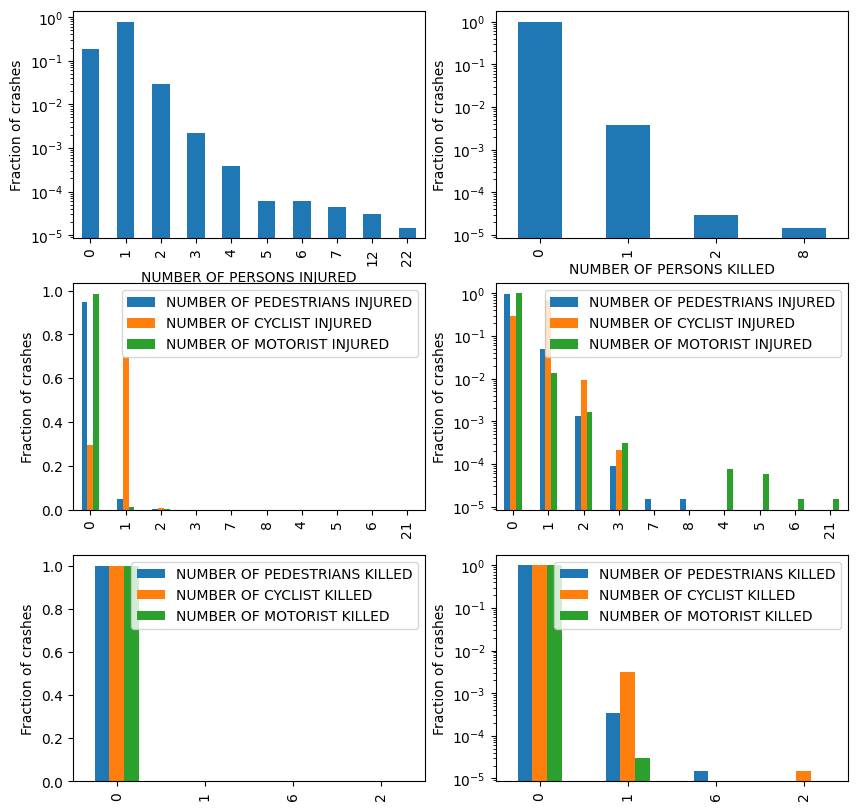

In [221]:
fig, axs = plt.subplots(ncols=2, nrows=3, figsize=(10,10))
for i, colname in enumerate(["NUMBER OF PERSONS INJURED", "NUMBER OF PERSONS KILLED"]):
    (df_bike[colname].groupby(df_bike[colname]).count()/len(df_bike)).plot(ax=axs[0,i], kind="bar", xlabel=colname, ylabel="Fraction of crashes", logy=True)

dfs = []
for colname, color in {
    # "NUMBER OF PERSONS INJURED": "gray", 
    "NUMBER OF PEDESTRIANS INJURED": "green", 
    "NUMBER OF CYCLIST INJURED": "red", 
    "NUMBER OF MOTORIST INJURED": "blue"}.items():
    # (df_bike[colname].groupby(df_bike[colname]).count()/len(df_bike)).plot(ax=axs[0], kind="bar", xlabel="Number of persons injured", ylabel="Fraction of crashes", logy=True, color=color, alpha=0.5)
    s = df_bike[colname].groupby(df_bike[colname]).count()/len(df_bike)
    s.name = colname
    dfs.append(s)
df_plot = pd.concat(dfs, axis=1)
df_plot.fillna(0.0)
df_plot.plot(ax=axs[1,0], kind="bar", ylabel="Fraction of crashes")
df_plot.plot(ax=axs[1,1], kind="bar", logy=True, ylabel="Fraction of crashes")

dfs = []
for colname, color in {
    # "NUMBER OF PERSONS INJURED": "gray", 
    "NUMBER OF PEDESTRIANS KILLED": "green", 
    "NUMBER OF CYCLIST KILLED": "red", 
    "NUMBER OF MOTORIST KILLED": "blue"}.items():
    s = df_bike[colname].groupby(df_bike[colname]).count()/len(df_bike)
    s.name = colname
    dfs.append(s)
df_plot = pd.concat(dfs, axis=1)
df_plot.fillna(0.0)
df_plot.plot(ax=axs[2,0], kind="bar", ylabel="Fraction of crashes")
df_plot.plot(ax=axs[2,1], kind="bar", logy=True, ylabel="Fraction of crashes")


- Keep in mind: This is all with respect to crashes in which a bike is involved
- Injured:
    - In 20% no person was injured;
    - In 80% one person was injured
    - More than two is minor (a few large crashes with a lot of motorists involved)
- Killed:
    - In 0.5% of crashes a person died. 1 in 200 is quiet a lot!
- Most of the times the cyclist is injured
    - 10 times more often than a pedestrian
    - Motorist even less likely
- Similarly for killed
    - Almost always the cyclist dies; Ratios to pedestrians and motorists are similar to above
- Motivation for an insurance: Cyclists are very vulerable, especially in crashes with motorists!

In [226]:
import branca
fig = branca.element.Figure()

subplot1 = fig.add_subplot(1, 2, 1)
subplot2 = fig.add_subplot(1, 2, 2)


m = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_bike_plot.loc[df_bike_plot["NUMBER OF CYCLIST INJURED"] > 0, ["LATITUDE","LONGITUDE"]],
    radius = 10,
    blur = 10,
    ).add_to(m)
print("Left heatmap of crashes where Cyclist got injured")
subplot1.add_child(m)

n = folium.Map(
    max_bounds=True,
    location=[40.76, -73.98], 
    zoom_start=11, 
    tiles="CartoDB positron", 
    control_scale=True,
)

HeatMap(
    df_bike_plot.loc[df_bike_plot["NUMBER OF CYCLIST KILLED"] > 0, ["LATITUDE","LONGITUDE"]],
    radius = 10,
    blur = 10,
    ).add_to(n)
print("Right heatmap of crashes where Cyclist got killed")
subplot2.add_child(n)

fig

Left heatmap of crashes where Cyclist got injured
Right heatmap of crashes where Cyclist got killed


- No clear pattern visible to me
- I think more often at larger roads
- Not at the coast where there are separate bike lanes / no cars
- No apperent correlation with CitiBike station positions

<Axes: xlabel='DATE', ylabel='Mean number of cyclists killed'>

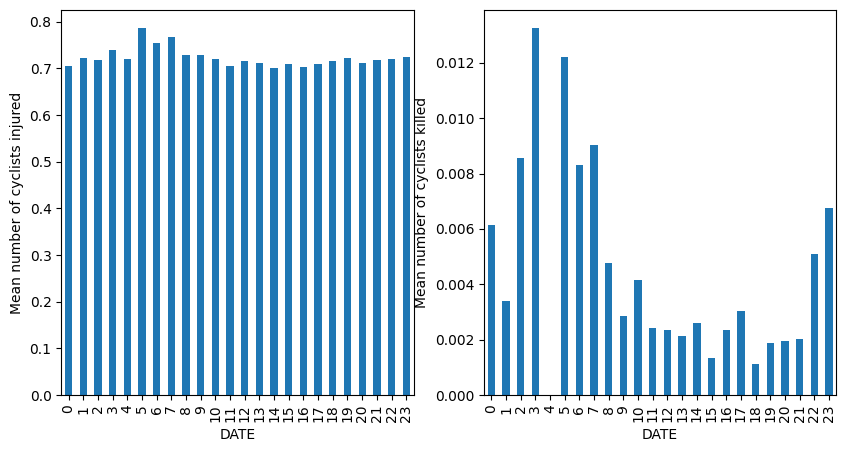

In [259]:
fig, axs = plt.subplots(ncols=2, nrows=1, figsize=(10,5))

df_bike["NUMBER OF CYCLIST INJURED"].groupby(df_bike["DATE"].dt.hour).mean().plot(ax=axs[0], kind="bar", ylabel="Mean number of cyclists injured")
df_bike["NUMBER OF CYCLIST KILLED"].groupby(df_bike["DATE"].dt.hour).mean().plot(ax=axs[1], kind="bar", ylabel="Mean number of cyclists killed")

- Deaths mainly occur in the at night and in morning

# 4. Analyse contributing vehicles and factors

In [264]:
df = pd.read_csv(f"{path}/data/Motor_Vehicle_Collisions_-_Crashes_20251030.csv", dtype = dtype_dict, parse_dates={"DATE": ["CRASH DATE", "CRASH TIME"]})
df_bike = df[df[[f"VEHICLE TYPE CODE {x}" for x in range(1,6)]].apply(lambda col: col.astype(str).str.contains('Bike').any(), axis=1)]

Most frequent vehicles involved in crashes with bikes
Left: All crashes, Mid: Person injured, Right: Person killed


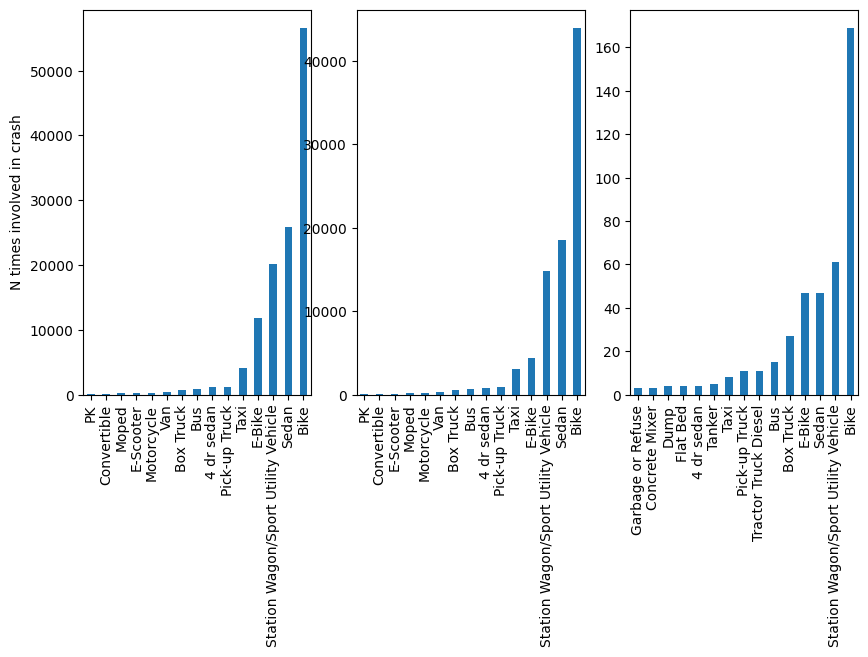

In [307]:
fig, axs = plt.subplots(ncols=3, nrows=1, figsize=(10,5))

vehicles = pd.concat([df_bike[f"VEHICLE TYPE CODE {x}"] for x in range(1,6)])
vehicles_injured = pd.concat([df_bike.loc[df_bike["NUMBER OF CYCLIST INJURED"] > 0, f"VEHICLE TYPE CODE {x}"] for x in range(1,6)])
vehicles_killed = pd.concat([df_bike.loc[df_bike["NUMBER OF CYCLIST KILLED"] > 0, f"VEHICLE TYPE CODE {x}"] for x in range(1,6)])

vehicles.groupby(vehicles).count().dropna().sort_values().iloc[-15:].plot(ax=axs[0], kind="bar", logy=False, ylabel="N times involved in crash")
vehicles_injured.groupby(vehicles_injured).count().dropna().sort_values().iloc[-15:].plot(ax=axs[1], kind="bar")
vehicles_killed.groupby(vehicles_killed).count().dropna().sort_values().iloc[-15:].plot(ax=axs[2], kind="bar")

print("Most frequent vehicles involved in crashes with bikes")
print("Left: All crashes, Mid: Person injured, Right: Person killed")

- Crashes mostly with cars
- The deadly crashes are with larger cars, trucks, busses
- SUV/SW more likely to be deadly than Sedan
- Insurance: Cars are getting bigger and bigger --> Higher risk for bikers
- CitiBike: Suggest bike routes with less motorist traffic, different from Bus routes, etc.

/var/folders/df/yxx0t_dj3c57cs9tzhnfgt700000gn/T/ipykernel_43522/4234467105.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_bike["CrashContributer"] = df_bike.apply(CrashContributer, axis=1)


<Axes: xlabel='CrashContributer'>

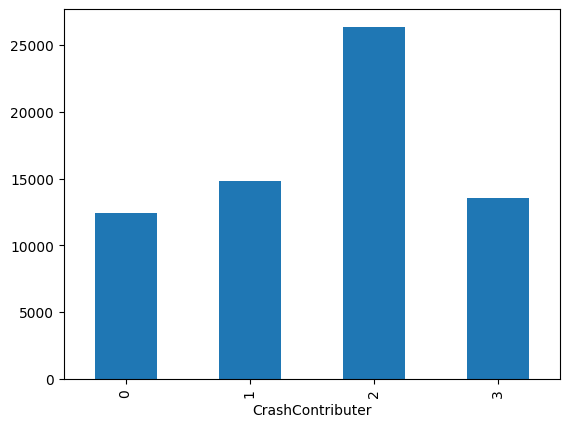

In [316]:
def CrashContributer(x):
    BikeContributed = False
    OtherContributed = False
    for i in range(1,6):
        VTC = x[f"VEHICLE TYPE CODE {i}"]
        CFV = x[f"CONTRIBUTING FACTOR VEHICLE {i}"]
        if pd.isnull(VTC):
            continue
        if "Bike" in VTC and not (pd.isnull(CFV) or CFV=='Unspecified'):
            BikeContributed = True
        elif not pd.isnull(VTC) and not (pd.isnull(CFV) or CFV=='Unspecified'):
            OtherContributed = True
    if BikeContributed and OtherContributed:
        return 3
    elif OtherContributed:
        return 2
    elif BikeContributed:
        return 1
    else: # No reason mentioned
        return 0

df_bike["CrashContributer"] = df_bike.apply(CrashContributer, axis=1)

df_bike["CrashContributer"].groupby(df_bike["CrashContributer"]).count().plot(kind="bar")

In [343]:
with pd.option_context('display.max_columns', None, 'display.max_rows', None): 
    # display(df_bike[["VEHICLE TYPE CODE 1", "CONTRIBUTING FACTOR VEHICLE 1"]].iloc[:1000])
    display(df_bike["CONTRIBUTING FACTOR VEHICLE 1"].drop_duplicates())

33                                               Unspecified
37                            Driver Inattention/Distraction
49         Pedestrian/Bicyclist/Other Pedestrian Error/Co...
53                               Traffic Control Disregarded
62                                   View Obstructed/Limited
76                            Passing or Lane Usage Improper
90                                     Following Too Closely
163                                    Passenger Distraction
185                            Failure to Yield Right-of-Way
199                                             Unsafe Speed
201                                       Turning Improperly
312                                      Driver Inexperience
330                                      Alcohol Involvement
420                                     Unsafe Lane Changing
1241                                         Other Vehicular
1374                                 Tire Failure/Inadequate
1688                    

57


<Axes: ylabel='N times mentioned'>

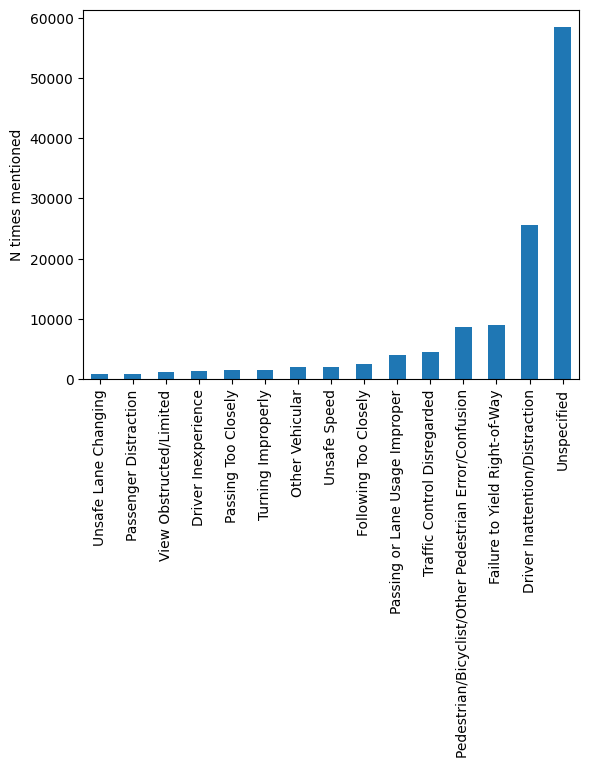

In [347]:
factors = pd.concat([df_bike[f"CONTRIBUTING FACTOR VEHICLE {x}"] for x in range(1,6)])
print(len(factors.unique()))
factors.groupby(factors).count().sort_values().iloc[-15:].plot(kind="bar", logy=False, ylabel="N times mentioned")


In [340]:
df_bike[["VEHICLE TYPE CODE 1", "CONTRIBUTING FACTOR VEHICLE 1", "VEHICLE TYPE CODE 2", "CONTRIBUTING FACTOR VEHICLE 2", "NUMBER OF CYCLIST INJURED", "NUMBER OF CYCLIST KILLED"]].to_csv(f"{path}/data/CrashBike-ChatGPT.csv", index=False)

- In the "Contributing Factor Vehicle" column there seem to be a few typical classes, but I suppose the number of classes is very large or officers can even input their own text
    - 57 unique entries
    - Some of them are even closely related
- LLMs seem perfect for this task to interpret the text and also identify connects between similar classes
- I asked ChatGPT and the results are below (in agreement with some small studies I did above)

**Crashes Caused by Bikes / E-Bikes / E-Scooters**
| Rank | Cause                                                       |     Count |
| ---- | ----------------------------------------------------------- | --------: |
| 1    | Driver Inattention / Distraction                            | **6,060** |
| 2    | Unspecified                                                 | **5,021** |
| 3    | Failure to Yield Right-of-Way                               | **2,362** |
| 4    | Pedestrian / Bicyclist / Other Pedestrian Error / Confusion | **1,839** |
| 5    | Traffic Control Disregarded                                 | **1,003** |
| 6    | Passing or Lane Usage Improper                              |   **928** |
| 7    | Following Too Closely                                       |   **732** |
| 8    | Unsafe Speed                                                |   **677** |
| 9    | Driver Inexperience                                         |   **511** |
| 10   | Other Vehicular                                             |   **469** |

**Summary**: Most bike-related crashes result from inattention, failure to yield, and traffic violations, with speed and inexperience also contributing.

**The same below but only for crashes in which a cyclist died**

**Crashes Caused by Cars (Sedan, SUV, Taxi, etc.)**
| Rank | Cause                                                       |      Count |
| ---- | ----------------------------------------------------------- | ---------: |
| 1    | Driver Inattention / Distraction                            | **12,811** |
| 2    | Unspecified                                                 |  **6,849** |
| 3    | Failure to Yield Right-of-Way                               |  **5,593** |
| 4    | Pedestrian / Bicyclist / Other Pedestrian Error / Confusion |  **4,056** |
| 5    | Traffic Control Disregarded                                 |  **2,569** |
| 6    | Passing or Lane Usage Improper                              |  **1,874** |
| 7    | Following Too Closely                                       |  **1,035** |
| 8    | Turning Improperly                                          |  **1,007** |
| 9    | Unsafe Speed                                                |    **772** |
| 10   | Other Vehicular                                             |    **760** |

**Summary**: For cars, driver distraction, failure to yield, and improper maneuvers (lane usage, turning) are the dominant causes.


**Bikes / E-Bikes Involved in Fatal Crashes**
| Rank | Cause                                                       |  Count |
| ---- | ----------------------------------------------------------- | -----: |
| 1    | Unspecified                                                 | **13** |
| 2    | Pedestrian / Bicyclist / Other Pedestrian Error / Confusion |  **9** |
| 3    | Failure to Yield Right-of-Way                               |  **8** |
| 4    | Driver Inattention / Distraction                            |  **6** |
| 5    | Alcohol Involvement                                         |  **4** |
| 6    | Pavement Defective                                          |  **3** |
| 7    | Lost Consciousness                                          |  **3** |
| 8    | Traffic Control Disregarded                                 |  **3** |
| 9    | Unsafe Speed                                                |  **2** |
| 10   | Oversized Vehicle                                           |  **1** |

Cars Involved in Crashes Killing Cyclists
| Rank | Cause                                                       |  Count |
| ---- | ----------------------------------------------------------- | -----: |
| 1    | Driver Inattention / Distraction                            | **26** |
| 2    | Unspecified                                                 | **21** |
| 3    | Pedestrian / Bicyclist / Other Pedestrian Error / Confusion | **20** |
| 4    | Traffic Control Disregarded                                 | **16** |
| 5    | Failure to Yield Right-of-Way                               | **10** |
| 6    | Unsafe Speed                                                |  **8** |
| 7    | Passing or Lane Usage Improper                              |  **3** |
| 8    | Alcohol Involvement                                         |  **3** |
| 9    | Driver Inexperience                                         |  **1** |
| 10   | Turning Improperly                                          |  **1** |

**Key Insights**
- Driver inattention/distraction is the most frequent cause overall — both in ordinary and fatal crashes.
- Failure to yield and traffic control violations remain critical factors across all vehicle types.
- For fatal crashes, additional factors such as alcohol involvement, unsafe speed, and poor road conditions appear more often.
- E-bike riders may be at higher risk due to speed and inexperience, while car drivers pose risk mainly through distraction and not yielding.
- Factors related to the bike itself like mechanical problems, broken tires, etc. are almost negigible. Interesting for CitiBike 